<h3><center>This is the notebook for submission for the "A Safer Seattle" project.</center></h3>

<h1><center>A Safer Seattle</center></h1>

<h2>Load the Required Libraries</h2>

In [2]:
import pandas as pd
import numpy as np
import itertools
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
import matplotlib.ticker as ticker
from sklearn import preprocessing
%matplotlib inline

<h2>Download and Load the Dataset</h2>

In [3]:
#download the data set
!wget -O collisions_data.csv https://s3.us.cloud-object-storage.appdomain.cloud/cf-courses-data/CognitiveClass/DP0701EN/version-2/Data-Collisions.csv

#load the data set from CSV file
df = pd.read_csv('collisions_data.csv')
df.head()

--2020-09-22 21:41:31--  https://s3.us.cloud-object-storage.appdomain.cloud/cf-courses-data/CognitiveClass/DP0701EN/version-2/Data-Collisions.csv
Resolving s3.us.cloud-object-storage.appdomain.cloud (s3.us.cloud-object-storage.appdomain.cloud)... 67.228.254.196
Connecting to s3.us.cloud-object-storage.appdomain.cloud (s3.us.cloud-object-storage.appdomain.cloud)|67.228.254.196|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 73917638 (70M) [text/csv]
Saving to: ‘collisions_data.csv’

100%[======================================>] 73,917,638  38.9MB/s   in 1.8s   

2020-09-22 21:41:34 (38.9 MB/s) - ‘collisions_data.csv’ saved [73917638/73917638]



/opt/conda/envs/Python36/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3020: DtypeWarning: Columns (33) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,SEVERITYCODE,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,...,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,2,-122.323148,47.703140,1,1307,1307,3502005,Matched,Intersection,37475.0,...,Wet,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
1,1,-122.347294,47.647172,2,52200,52200,2607959,Matched,Block,NaN,...,Wet,Dark - Street Lights On,NaN,6354039.0,NaN,11,From same direction - both going straight - bo...,0,0,N
2,1,-122.334540,47.607871,3,26700,26700,1482393,Matched,Block,NaN,...,Dry,Daylight,NaN,4323031.0,NaN,32,One parked--one moving,0,0,N
3,1,-122.334803,47.604803,4,1144,1144,3503937,Matched,Block,NaN,...,Dry,Daylight,NaN,NaN,NaN,23,From same direction - all others,0,0,N
4,2,-122.306426,47.545739,5,17700,17700,1807429,Matched,Intersection,34387.0,...,Wet,Daylight,NaN,4028032.0,NaN,10,Entering at angle,0,0,N


<h2>Clean the Dataset</h2>

**Let's begin by looking at the data included in our data set and remove columns that we don't intend to use for analysis.**

In [4]:
df.shape

(194673, 38)

In [5]:
df.dtypes

SEVERITYCODE        int64
X                 float64
Y                 float64
OBJECTID            int64
INCKEY              int64
COLDETKEY           int64
REPORTNO           object
STATUS             object
ADDRTYPE           object
INTKEY            float64
LOCATION           object
EXCEPTRSNCODE      object
EXCEPTRSNDESC      object
SEVERITYCODE.1      int64
SEVERITYDESC       object
COLLISIONTYPE      object
PERSONCOUNT         int64
PEDCOUNT            int64
PEDCYLCOUNT         int64
VEHCOUNT            int64
INCDATE            object
INCDTTM            object
JUNCTIONTYPE       object
SDOT_COLCODE        int64
SDOT_COLDESC       object
INATTENTIONIND     object
UNDERINFL          object
WEATHER            object
ROADCOND           object
LIGHTCOND          object
PEDROWNOTGRNT      object
SDOTCOLNUM        float64
SPEEDING           object
ST_COLCODE         object
ST_COLDESC         object
SEGLANEKEY          int64
CROSSWALKKEY        int64
HITPARKEDCAR       object
dtype: objec

In [6]:
df.isnull().sum()

SEVERITYCODE           0
X                   5334
Y                   5334
OBJECTID               0
INCKEY                 0
COLDETKEY              0
REPORTNO               0
STATUS                 0
ADDRTYPE            1926
INTKEY            129603
LOCATION            2677
EXCEPTRSNCODE     109862
EXCEPTRSNDESC     189035
SEVERITYCODE.1         0
SEVERITYDESC           0
COLLISIONTYPE       4904
PERSONCOUNT            0
PEDCOUNT               0
PEDCYLCOUNT            0
VEHCOUNT               0
INCDATE                0
INCDTTM                0
JUNCTIONTYPE        6329
SDOT_COLCODE           0
SDOT_COLDESC           0
INATTENTIONIND    164868
UNDERINFL           4884
WEATHER             5081
ROADCOND            5012
LIGHTCOND           5170
PEDROWNOTGRNT     190006
SDOTCOLNUM         79737
SPEEDING          185340
ST_COLCODE            18
ST_COLDESC          4904
SEGLANEKEY             0
CROSSWALKKEY           0
HITPARKEDCAR           0
dtype: int64

**Removing some unnecessary columns:**

In [7]:
df.drop(['STATUS','JUNCTIONTYPE','SEVERITYDESC','REPORTNO',], axis=1, inplace=True)
df.shape

(194673, 34)

**Only a very small percentage of data rows have no coordinate data for the accident location.  Many of these also have other missing data.  So let's remove the accidents that have no location data.**


In [8]:
#Remove rows with no X-Y coordinate data.
df = df.dropna(subset=['X', 'Y'])
df.shape

(189339, 34)

**We see below that we have data extending back to 2004.  Let's focus on the three most recent, complete years of data:  2017-2019**

In [9]:
#Number of accidents each year for the entire dataset.
df['year'] = pd.DatetimeIndex(df['INCDATE']).year
df['year'].value_counts()

2006    14816
2005    14760
2007    14036
2008    13170
2015    12434
2004    11568
2014    11486
2016    11325
2009    11312
2012    10616
2011    10602
2017    10578
2010    10533
2013    10314
2018    10224
2019     9334
2020     2231
Name: year, dtype: int64

In [10]:
#dataframe for the years 2017-2019
df_last3 = df[(df['year'] > 2016) & (df['year'] < 2020)]
df_last3['year'].value_counts()

2017    10578
2018    10224
2019     9334
Name: year, dtype: int64

<h2>Analyze Data and Create Appropriate Visualizations</h2>

Now let's consider a range of data features such as specific intersections, general accident areas, speeding, and weather conditions.

In [11]:
#Let's look first at the number of accidents at various intersections using the 'INTKEY' column
df_last3['INTKEY'].value_counts().head(20)


29973.0    56
29913.0    34
29576.0    32
35996.0    31
35910.0    30
29929.0    29
29878.0    29
35853.0    28
29380.0    28
33022.0    27
29947.0    27
31517.0    26
33135.0    26
30410.0    25
36499.0    25
29852.0    24
29761.0    23
27070.0    23
37466.0    23
32416.0    22
Name: INTKEY, dtype: int64

**While some intersecitions have more accidents than others, we can see that 'INTKEY' = 29973.0 is an intersection that has far more accidents than any other.  Let's record this location for identification later on a map.**

In [12]:
#Load statistics and use mode to find the most frequently occuring intersection key.
import statistics 
from statistics import mode
badint = mode(df_last3.INTKEY)
badint

29973.0

In [13]:
df.INTKEY

0         37475.0
1             NaN
2             NaN
3             NaN
4         34387.0
5         36974.0
6         29510.0
7         29745.0
8             NaN
9         34679.0
11        33194.0
12            NaN
13            NaN
14            NaN
15            NaN
16        37365.0
18            NaN
19            NaN
20            NaN
21        36505.0
22            NaN
23            NaN
24        33499.0
25            NaN
26        29865.0
27            NaN
28            NaN
30        29959.0
31        30413.0
32        31510.0
           ...   
194642    35827.0
194643        NaN
194644    30479.0
194645    29973.0
194646        NaN
194647        NaN
194648        NaN
194649    29328.0
194650        NaN
194651    29745.0
194652        NaN
194653        NaN
194654    36427.0
194655    25174.0
194656    29545.0
194657        NaN
194658        NaN
194659        NaN
194661        NaN
194662        NaN
194663        NaN
194664    28300.0
194665    26005.0
194666        NaN
194667    

In [15]:
#Take the coordinates of the bad intersection:
df_badint = df_last3[df_last3.INTKEY == badint]
df_badint.head()
coords = df_badint.iloc[0,[1,2]]
badintlong = coords['X']
badintlat = coords['Y']
print("The coordinates for the bad intersection are: ", badintlong, ", ", badintlat)

The coordinates for the bad intersection are:  -122.32807859999998 ,  47.60416123


**Before moving on, let's see how the proportion of injury-causing accidents at this bad intersection compares to that of the entire data set.**

In [16]:
df_badint['SEVERITYCODE'].value_counts(normalize = True)

1    0.553571
2    0.446429
Name: SEVERITYCODE, dtype: float64

In [17]:
df_last3['SEVERITYCODE'].value_counts(normalize = True)

1    0.677694
2    0.322306
Name: SEVERITYCODE, dtype: float64

**So, we can see that the percentage of injury-causing accidents at this intersection is nearly 45%, while that percentage for all accidents city-wide is only 32%.  So, we can see that this intersection is not only associated with a higher number of accidents, but also a greater proportion of dangerous accidents.**

**Now let's visualize all of the accidents over the 2017-2019 period on a map.  Since we are particularly interested in minimizing dangerous, injury-causing accidents, we will differentiate accidents by severity using colored markers.**

<h2>Maps with Markers Using Folium</h2>

In [18]:
#Install and import folium
!conda install -c conda-forge folium=0.5.0 --yes
import folium

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - folium=0.5.0


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    ca-certificates-2020.6.20  |       hecda079_0         145 KB  conda-forge
    openssl-1.1.1h             |       h516909a_0         2.1 MB  conda-forge
    certifi-2020.6.20          |   py36h9f0ad1d_0         151 KB  conda-forge
    folium-0.5.0               |             py_0          45 KB  conda-forge
    altair-4.1.0               |             py_1         614 KB  conda-forge
    vincent-0.4.4              |             py_1          28 KB  conda-forge
    python_abi-3.6             |          1_cp36m           4 KB  conda-forge
    branca-0.4.1               |             py_0          26 KB  conda-forge
    ------------------------------------------------------------
                       

**Now let's create a map of Seattle.**

In [19]:
latitude = 47.61
longitude = -122.33

seattle_map = folium.Map(location=[latitude, longitude], zoom_start=12)

# display the map of Seattle
seattle_map

**Now we will superimpose on the map a mark cluster object for the accidents in the dataframe.**

In [20]:
from folium import plugins

df_last3["SEVERITYCODE"] = df_last3["SEVERITYCODE"].astype('str')

# instantiate a mark cluster object for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(seattle_map)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng, label, in zip(df_last3.Y, df_last3.X, df_last3.SEVERITYCODE):
    if label == '1':
        folium.Marker(
            location=[lat, lng],
            icon=folium.Icon(color='blue'),
        ).add_to(incidents)
    else:
        folium.Marker(
            location=[lat, lng],
            icon=folium.Icon(color='red'),
        ).add_to(incidents)


# identify the location of the bad intersection on the map also.
bad_intersection = folium.map.FeatureGroup()

bad_intersection.add_child(
    folium.features.CircleMarker(
        [badintlat, badintlong],
        radius=10, 
        color='green',
        fill=True,
        fill_color='red',
        fill_opacity=0.9
    )
)

            
# add incidents to map

seattle_map.add_child(bad_intersection)


/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


**Let's create another map, this time, focusing only on the accidents that involved speeding.  Again, we will differentiate the accidents by severity using marker color.**

In [21]:
df_speed = df_last3.dropna(subset=['SPEEDING'])

df_speed.shape

(1010, 35)

In [22]:
#Let's instantiate a new map of Seattle
latitude = 47.61
longitude = -122.33

new_seattle_map = folium.Map(location=[latitude, longitude], zoom_start=12)

# display the map of Seattle
new_seattle_map



#create an incidents feature group
incidents_speed_colored = folium.map.FeatureGroup()

# loop through the accidents involving speeding and add each to the incidents feature group
for lat, lng, label in zip(df_speed.Y, df_speed.X, df_speed.SEVERITYCODE):
    if label == '1':
        incidents_speed_colored.add_child(
            folium.features.CircleMarker(
                [lat, lng],
                radius=2, 
                color='blue',
                fill=True,
                fill_color='blue',
                fill_opacity=0.6
            )
        )
    else:
        incidents_speed_colored.add_child(
            folium.features.CircleMarker(
                [lat, lng],
                radius=2, 
                color='red',
                fill=True,
                fill_color='red',
                fill_opacity=0.6
            )
        )
        
# add incidents to map

new_seattle_map.add_child(incidents_speed_colored)

**Now, let's look at weather and road conditions.**

In [23]:
df_last3['WEATHER'].value_counts()

Clear                       18358
Raining                      4924
Overcast                     4006
Unknown                       839
Snowing                       161
Fog/Smog/Smoke                124
Other                          82
Blowing Sand/Dirt              20
Sleet/Hail/Freezing Rain       13
Severe Crosswind                9
Name: WEATHER, dtype: int64

In [24]:
df_last3['ROADCOND'].value_counts()

Dry               20112
Wet                7235
Unknown             859
Snow/Slush          163
Ice                 150
Other                18
Standing Water       12
Oil                   9
Sand/Mud/Dirt         7
Name: ROADCOND, dtype: int64

Let's first remove null values.

In [25]:
df_weath_road = df_last3[['WEATHER','ROADCOND','SEVERITYCODE']]
df_weath_road.shape

df_weath_road.dropna(how = 'any', inplace = True)
df_weath_road.shape


/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


(28519, 3)

In [26]:
df_weath_road.isnull().sum()

WEATHER         0
ROADCOND        0
SEVERITYCODE    0
dtype: int64

In [28]:
#Make a dataframe showing the number of accidents by severity for various road conditions
df_roads = df_weath_road[['SEVERITYCODE', 'ROADCOND']]
df_roads.head(10)
df_roads['Occurences'] = df_roads.SEVERITYCODE
df_new_roads = df_roads.groupby(['ROADCOND','SEVERITYCODE'],as_index = False).count().pivot('ROADCOND','SEVERITYCODE').fillna(0)
df_new_roads

Occurences        
SEVERITYCODE            1       2
ROADCOND                         
Dry               13234.0  6852.0
Ice                 106.0    42.0
Oil                   9.0     0.0
Other                10.0     8.0
Sand/Mud/Dirt         5.0     1.0
Snow/Slush          130.0    32.0
Standing Water       10.0     2.0
Unknown             775.0    81.0
Wet                4763.0  2459.0

In [38]:
#Sort the dataframe and clean out rows with minimal occurences
df_sorted_roads = df_new_roads.sort_values(by=[('Occurences', '1')], ascending = False)
df_final_road= df_sorted_roads.head()
df_final_road

Occurences        
SEVERITYCODE          1       2
ROADCOND                       
Dry             13234.0  6852.0
Wet              4763.0  2459.0
Unknown           775.0    81.0
Snow/Slush        130.0    32.0
Ice               106.0    42.0

**Let's plot a bar chart showing car accidents in various road conditions categorized by severity.**

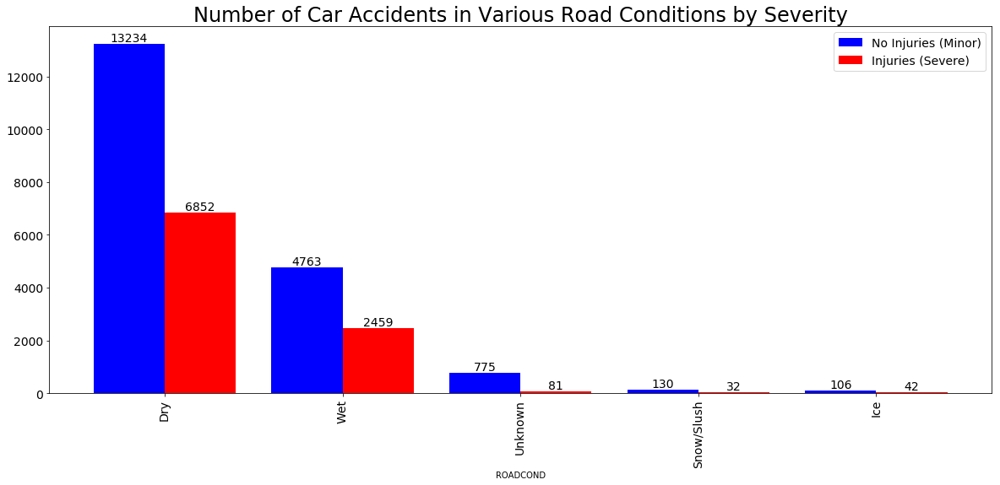

In [53]:
#Plot a bar chart
ax = df_final_road.plot.bar(figsize=(20, 8), width = 0.8, color=['blue', 'red'], fontsize = 14)
ax.set_title("Number of Car Accidents in Various Road Conditions by Severity", fontsize = 24)
#ax.spines['top'].set_visible(False)
#ax.spines['right'].set_visible(False)
#ax.spines['left'].set_visible(False)
#ax.get_yaxis().set_ticks([])
ax.legend(['No Injuries (Minor)', 'Injuries (Severe)'], fontsize = 14)
for i in ax.patches:
    ax.annotate("%.0f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()), ha='center', va='center', xytext=(0, 7), textcoords='offset points', fontsize = 14)

**Now let's repeat for weather conditions.** 

In [49]:
#Make a dataframe showing the number of accidents by severity for various weather conditions
df_weather = df_weath_road[['SEVERITYCODE', 'WEATHER']]
df_weather.head(10)
df_weather['Occurences'] = df_roads.SEVERITYCODE
df_new_weather = df_weather.groupby(['WEATHER','SEVERITYCODE'],as_index = False).count().pivot('WEATHER','SEVERITYCODE').fillna(0)
df_new_weather

Occurences      
SEVERITYCODE                      1     2
WEATHER                                  
Blowing Sand/Dirt                16     4
Clear                         12064  6286
Fog/Smog/Smoke                   80    44
Other                            64    18
Overcast                       2683  1319
Raining                        3228  1695
Severe Crosswind                  6     3
Sleet/Hail/Freezing Rain         10     3
Snowing                         125    36
Unknown                         766    69

In [50]:
#Sort the dataframe and clean out rows with minimal occurences
df_sorted_weather = df_new_weather.sort_values(by=[('Occurences', '1')], ascending = False)
df_final_weather= df_sorted_weather.head()
df_final_weather

Occurences      
SEVERITYCODE          1     2
WEATHER                      
Clear             12064  6286
Raining            3228  1695
Overcast           2683  1319
Unknown             766    69
Snowing             125    36

**Let's plot a bar chart showing car accidents in various weather conditions categorized by severity.**

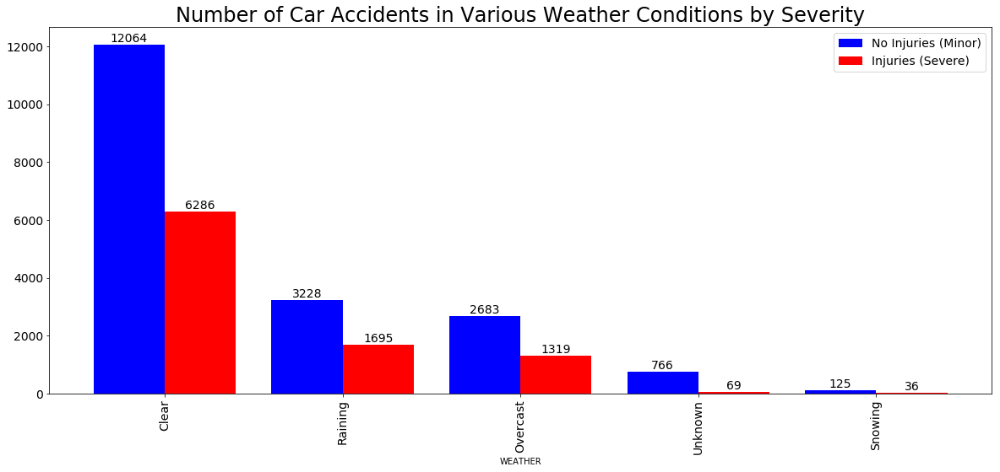

In [54]:
#Plot a bar chart
ax2 = df_final_weather.plot.bar(figsize=(20, 8), width = 0.8, color=['blue', 'red'], fontsize = 14)
ax2.set_title("Number of Car Accidents in Various Weather Conditions by Severity", fontsize = 24)
#ax2.spines['top'].set_visible(False)
#ax2.spines['right'].set_visible(False)
#ax2.spines['left'].set_visible(False)
#ax2.get_yaxis().set_ticks([])
ax2.legend(['No Injuries (Minor)', 'Injuries (Severe)'], fontsize = 14)
for i in ax2.patches:
    ax2.annotate("%.0f" % i.get_height(), (i.get_x() + i.get_width() / 2., i.get_height()), ha='center', va='center', xytext=(0, 7), textcoords='offset points', fontsize = 14)

<h2>Machine Learning Models for Weather Conditions</h2>

While our analysis of intersections, speeding, and location data provided some actionable insights, our bar charts of road and weather conditions did not yield any obvious results.  So, let's apply a machine learning model to our weather data.

**We will use Location (X-Y Coordinates), Weather Conditions, Speeding Cars, and Drivers Under the Influence as our predictors for our target variable, 'SEVERITYCODE'.**

In [107]:
df_ml_last3 = df_last3[['X', 'Y', 'WEATHER','SPEEDING','UNDERINFL','SEVERITYCODE']]
df_ml_last3

,X,Y,WEATHER,SPEEDING,UNDERINFL,SEVERITYCODE
5,-122.387598,47.690575,Clear,NaN,N,1
25,-122.312857,47.599218,Clear,NaN,N,2
35,-122.318741,47.676567,Raining,NaN,N,1
45,-122.307487,47.592295,Clear,NaN,N,1
58,-122.347339,47.661445,Overcast,NaN,N,2
75,-122.360524,47.519195,NaN,NaN,NaN,1
77,-122.345863,47.612991,Raining,NaN,N,1
86,-122.314917,47.526016,Clear,NaN,N,1
112,-122.287172,47.606655,Overcast,NaN,N,1
114,-122.315442,47.661285,Clear,NaN,N,2


In [108]:
#check for null values
df_ml_last3.isnull().sum()

X                   0
Y                   0
WEATHER          1600
SPEEDING        29126
UNDERINFL        1531
SEVERITYCODE        0
dtype: int64

In [109]:
#remove the rows with null values for weather.
df_ml_last3 = df_ml_last3.dropna(subset = ['WEATHER'])
df_ml_last3.isnull().sum()

X                   0
Y                   0
WEATHER             0
SPEEDING        27530
UNDERINFL           0
SEVERITYCODE        0
dtype: int64

**We removed the rows with null weather values as they are a relatively small number (~5%) and it's the most reasonable solution.  It just so happens that in doing so, we remove all of the 'UNDERINFL' null values, solving two problems at once.**

In [110]:
#Check value counts for speeding to make sure it is the complement of the number of null values.
df_ml_last3['SPEEDING'].value_counts()


Y    1006
Name: SPEEDING, dtype: int64

In [111]:
df_ml_last3.dtypes

X               float64
Y               float64
WEATHER          object
SPEEDING         object
UNDERINFL        object
SEVERITYCODE     object
dtype: object

In [114]:
#Convert SPEEDING values to numerical.
df_ml_last3['SPEEDING'] = df_ml_last3['SPEEDING'].replace(np.nan, 0)
df_ml_last3['SPEEDING'] = df_ml_last3['SPEEDING'].replace('Y', 1)
df_ml_last3.head(80)

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


,X,Y,WEATHER,SPEEDING,UNDERINFL,SEVERITYCODE
5,-122.387598,47.690575,Clear,0,N,1
25,-122.312857,47.599218,Clear,0,N,2
35,-122.318741,47.676567,Raining,0,N,1
45,-122.307487,47.592295,Clear,0,N,1
58,-122.347339,47.661445,Overcast,0,N,2
77,-122.345863,47.612991,Raining,0,N,1
86,-122.314917,47.526016,Clear,0,N,1
112,-122.287172,47.606655,Overcast,0,N,1
114,-122.315442,47.661285,Clear,0,N,2
126,-122.362931,47.556356,Raining,0,N,1


In [121]:
#Convert UNDERINFL values to numerical.
df_ml_last3['UNDERINFL'] = df_ml_last3['UNDERINFL'].replace('Y', 1)
df_ml_last3['UNDERINFL'] = df_ml_last3['UNDERINFL'].replace('N', 0)
df_ml_last3.dtypes

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


X               float64
Y               float64
WEATHER          object
SPEEDING          int64
UNDERINFL         int64
SEVERITYCODE     object
dtype: object

In [193]:
df_ml_last3['SEVERITYCODE'].value_counts()

1    19055
2     9481
Name: SEVERITYCODE, dtype: int64

**Let's create a Feature dataframe with One Hot Encoding of the WEATHER feature.**

In [194]:
Feature = df_ml_last3[['X','Y','SPEEDING','UNDERINFL']]
#One Hot Encoding
Feature = pd.concat([Feature,pd.get_dummies(df_ml_last3['WEATHER'])], axis=1)
Feature.head()

,X,Y,SPEEDING,UNDERINFL,Blowing Sand/Dirt,Clear,Fog/Smog/Smoke,Other,Overcast,Raining,Severe Crosswind,Sleet/Hail/Freezing Rain,Snowing,Unknown
5,-122.387598,47.690575,0,0,0,1,0,0,0,0,0,0,0,0
25,-122.312857,47.599218,0,0,0,1,0,0,0,0,0,0,0,0
35,-122.318741,47.676567,0,0,0,0,0,0,0,1,0,0,0,0
45,-122.307487,47.592295,0,0,0,1,0,0,0,0,0,0,0,0
58,-122.347339,47.661445,0,0,0,0,0,0,1,0,0,0,0,0


In [195]:
#Name the Feature dataframe X.
X = Feature
X[0:5]




,X,Y,SPEEDING,UNDERINFL,Blowing Sand/Dirt,Clear,Fog/Smog/Smoke,Other,Overcast,Raining,Severe Crosswind,Sleet/Hail/Freezing Rain,Snowing,Unknown
5,-122.387598,47.690575,0,0,0,1,0,0,0,0,0,0,0,0
25,-122.312857,47.599218,0,0,0,1,0,0,0,0,0,0,0,0
35,-122.318741,47.676567,0,0,0,0,0,0,0,1,0,0,0,0
45,-122.307487,47.592295,0,0,0,1,0,0,0,0,0,0,0,0
58,-122.347339,47.661445,0,0,0,0,0,0,1,0,0,0,0,0


In [196]:
#Name the Target value array y.
y = df_ml_last3['SEVERITYCODE'].values
y[0:5]



array(['1', '2', '1', '1', '2'], dtype=object)

In [197]:
#Standard scale the Feature dataframe values to prepare for modeling.
X= preprocessing.StandardScaler().fit(X).transform(X)
X[0:5]

/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:2: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by StandardScaler.
  from ipykernel import kernelapp as app


array([[-1.94,  1.29, -0.19, -0.24, -0.03,  0.74, -0.07, -0.05, -0.4 ,
        -0.46, -0.02, -0.02, -0.08, -0.17],
       [ 0.59, -0.3 , -0.19, -0.24, -0.03,  0.74, -0.07, -0.05, -0.4 ,
        -0.46, -0.02, -0.02, -0.08, -0.17],
       [ 0.39,  1.04, -0.19, -0.24, -0.03, -1.34, -0.07, -0.05, -0.4 ,
         2.19, -0.02, -0.02, -0.08, -0.17],
       [ 0.77, -0.42, -0.19, -0.24, -0.03,  0.74, -0.07, -0.05, -0.4 ,
        -0.46, -0.02, -0.02, -0.08, -0.17],
       [-0.58,  0.78, -0.19, -0.24, -0.03, -1.34, -0.07, -0.05,  2.47,
        -0.46, -0.02, -0.02, -0.08, -0.17]])

**Split data into trainging and testing sets.**

In [198]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.2, random_state=4)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)


Train set: (22828, 14) (22828,)
Test set: (5708, 14) (5708,)



<h1>Machine Learning Models</h1>

<h2>Support Vector Machine</h2>

SVM models are able to adjust well to unbalanced datasets by weighting the classes in such a way as to appropriately penalize the model for misclassifying the minority class.  So, we will continue on for now without balancing the data.

In [199]:
from sklearn.metrics import classification_report, confusion_matrix
import itertools
from sklearn import svm
accidentsvm = svm.SVC(kernel='rbf',class_weight='balanced', probability=True)

accidentsvm.fit(X_train, y_train) 

yhatsvm = accidentsvm.predict(X_test)
yhatsvm [0:5]

/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/svm/base.py:196: FutureWarning: The default value of gamma will change from 'auto' to 'scale' in version 0.22 to account better for unscaled features. Set gamma explicitly to 'auto' or 'scale' to avoid this warning.
  "avoid this warning.", FutureWarning)


array(['1', '1', '1', '1', '1'], dtype=object)

In [151]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    
    
    

              precision    recall  f1-score   support

           1       0.69      0.63      0.66      3820
           2       0.36      0.42      0.39      1888

   micro avg       0.56      0.56      0.56      5708
   macro avg       0.52      0.53      0.52      5708
weighted avg       0.58      0.56      0.57      5708

Confusion matrix, without normalization
[[2396 1424]
 [1089  799]]
F1 Score:  0.5675838653157095
Jaccard Score:  0.5597407147862649


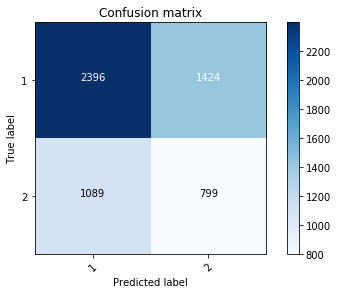

In [152]:
# Compute confusion matrix
cnf_matrix = confusion_matrix(y_test, yhatsvm, labels=['1','2'])
np.set_printoptions(precision=2)

print (classification_report(y_test, yhatsvm))

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['1','2'],normalize= False,  title='Confusion matrix')

print("F1 Score: ", metrics.f1_score(y_test, yhatsvm, average='weighted'))
print("Jaccard Score: ", metrics.jaccard_similarity_score(y_test, yhatsvm))


<h2>Decision Tree</h2>

**We will continue using our unbalanced dataset with our Decision Tree model, as decision trees often perform well on imbalanced data sets.**

In [160]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

accidentTree = RandomForestClassifier()
accidentTree

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators='warn', n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [161]:

accidentTree.fit(X_train,y_train)

accidentTree = accidentTree.predict(X_test)

print (accidentTree [0:5])
print (y_test [0:5])


print("DecisionTrees's Accuracy: ", metrics.accuracy_score(y_test, accidentTree))


/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


['2' '1' '1' '1' '1']
['2' '2' '2' '1' '1']
DecisionTrees's Accuracy:  0.6107217939733707


In [200]:
print (classification_report(y_test, accidentTree))

print("F1 Score: ", metrics.f1_score(y_test, accidentTree, average='weighted'))
print("Jaccard Score: ", metrics.jaccard_similarity_score(y_test, accidentTree))

              precision    recall  f1-score   support

           1       0.69      0.75      0.72      3820
           2       0.39      0.32      0.35      1888

   micro avg       0.61      0.61      0.61      5708
   macro avg       0.54      0.54      0.54      5708
weighted avg       0.59      0.61      0.60      5708

F1 Score:  0.599676821386807
Jaccard Score:  0.6107217939733707


<h2>K-Nearest Neighbors</h2>

We had an unbalanced data set, and we were able to deal with that in our Decision Tree model, as decision trees often perform well on imbalanced data sets.  
It was not a major problem with SVM either, because we could make the class weights balanced by appropriately penalizing the model for misclassifying the minority class.  
However, with KNN, we need to balance the dataset, and we will do so by umpsampling.

In [201]:
from sklearn.utils import resample

In [202]:
# Determine the imbalance
df_ml_last3['SEVERITYCODE'].value_counts()

1    19055
2     9481
Name: SEVERITYCODE, dtype: int64

In [203]:
df_ml_last3_large = df_ml_last3[df.SEVERITYCODE==1]
df_ml_last3_small = df_ml_last3[df.SEVERITYCODE==2]

# Upsample the small class
df_ml_last3_small_upsampled = resample(df_ml_last3_small, 
                                 replace=True,     # sample with replacement
                                 n_samples=19055,  # to match the size of the large class
                                 random_state=77) 
 
# Concatenate the large class and the upsampled small class
df_ml_last3_upsampled = pd.concat([df_ml_last3_large, df_ml_last3_small_upsampled])
 
# Check the new class counts
df_ml_last3_upsampled['SEVERITYCODE'].value_counts()


/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  if __name__ == '__main__':
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  from ipykernel import kernelapp as app


2    19055
1    19055
Name: SEVERITYCODE, dtype: int64

**Now are dataset is balanced.  Let's continue with our KNN model.**

In [204]:
#Create the Feature dataframe.
Feature = df_ml_last3_upsampled[['X','Y','SPEEDING','UNDERINFL']]
Feature = pd.concat([Feature,pd.get_dummies(df_ml_last3_upsampled['WEATHER'])], axis=1)
Feature.head()

,X,Y,SPEEDING,UNDERINFL,Blowing Sand/Dirt,Clear,Fog/Smog/Smoke,Other,Overcast,Raining,Severe Crosswind,Sleet/Hail/Freezing Rain,Snowing,Unknown
5,-122.387598,47.690575,0,0,0,1,0,0,0,0,0,0,0,0
35,-122.318741,47.676567,0,0,0,0,0,0,0,1,0,0,0,0
45,-122.307487,47.592295,0,0,0,1,0,0,0,0,0,0,0,0
77,-122.345863,47.612991,0,0,0,0,0,0,0,1,0,0,0,0
86,-122.314917,47.526016,0,0,0,1,0,0,0,0,0,0,0,0


In [205]:
#Name the Feature dataframe X.
X = Feature
X[0:5]

,X,Y,SPEEDING,UNDERINFL,Blowing Sand/Dirt,Clear,Fog/Smog/Smoke,Other,Overcast,Raining,Severe Crosswind,Sleet/Hail/Freezing Rain,Snowing,Unknown
5,-122.387598,47.690575,0,0,0,1,0,0,0,0,0,0,0,0
35,-122.318741,47.676567,0,0,0,0,0,0,0,1,0,0,0,0
45,-122.307487,47.592295,0,0,0,1,0,0,0,0,0,0,0,0
77,-122.345863,47.612991,0,0,0,0,0,0,0,1,0,0,0,0
86,-122.314917,47.526016,0,0,0,1,0,0,0,0,0,0,0,0


In [206]:
#Name the target array y.
y = df_ml_last3_upsampled['SEVERITYCODE'].values
y[0:5]


array(['1', '1', '1', '1', '1'], dtype=object)

In [207]:
#Standard scale the Feature data in preparation for modeling.
X= preprocessing.StandardScaler().fit(X).transform(X)
X[0:5]

/opt/conda/envs/Python36/lib/python3.6/site-packages/sklearn/preprocessing/data.py:645: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:2: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by StandardScaler.
  from ipykernel import kernelapp as app


array([[-1.95,  1.26, -0.2 , -0.24, -0.03,  0.74, -0.07, -0.05, -0.4 ,
        -0.46, -0.02, -0.02, -0.08, -0.16],
       [ 0.39,  1.02, -0.2 , -0.24, -0.03, -1.36, -0.07, -0.05, -0.4 ,
         2.18, -0.02, -0.02, -0.08, -0.16],
       [ 0.77, -0.43, -0.2 , -0.24, -0.03,  0.74, -0.07, -0.05, -0.4 ,
        -0.46, -0.02, -0.02, -0.08, -0.16],
       [-0.53, -0.08, -0.2 , -0.24, -0.03, -1.36, -0.07, -0.05, -0.4 ,
         2.18, -0.02, -0.02, -0.08, -0.16],
       [ 0.52, -1.57, -0.2 , -0.24, -0.03,  0.74, -0.07, -0.05, -0.4 ,
        -0.46, -0.02, -0.02, -0.08, -0.16]])

In [208]:
#Split the data into training and testing data.
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split( X, y, test_size=0.2, random_state=4)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)


Train set: (30488, 14) (30488,)
Test set: (7622, 14) (7622,)


In [209]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics

**Let's try to determine which value for k works best for our data.**

std acc:  [0.01 0.01 0.01 0.01 0.01 0.01 0.01]
mean acc:  [0.7  0.66 0.66 0.64 0.63 0.62 0.62]


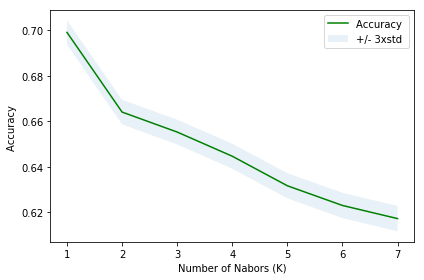

In [210]:
Ks = 8
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))
ConfusionMx = [];
for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,y_train)
    yhat=neigh.predict(X_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

print("std acc: ", std_acc)    
print("mean acc: ", mean_acc)

plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Nabors (K)')
plt.tight_layout()
plt.show()

**While 1 seems to be the obvious choice for k here, we must be careful of overfitting, as often occurs with small values for k.**

In [211]:
#Using k = 1 from above with the KNN training data
k = 1
neigh1 = KNeighborsClassifier(n_neighbors = k).fit(X_train, y_train)
neigh1
yhatknn = neigh1.predict(X_test)
print("yhat is ", yhatknn [0:5])
print("Train set Accuracy: ", metrics.accuracy_score(y_train, neigh1.predict(X_train)))
print("Test set Accuracy: ", metrics.accuracy_score(y_test, yhatknn))

print (classification_report(y_test, yhatknn))

print("F1 Score: ", metrics.f1_score(y_test, yhatknn, average='weighted'))
print("Jaccard Score: ", metrics.jaccard_similarity_score(y_test, yhatknn))


yhat is  ['2' '2' '2' '2' '2']
Train set Accuracy:  0.8497113618472841
Test set Accuracy:  0.6991603253739176
              precision    recall  f1-score   support

           1       0.73      0.63      0.68      3810
           2       0.68      0.76      0.72      3812

   micro avg       0.70      0.70      0.70      7622
   macro avg       0.70      0.70      0.70      7622
weighted avg       0.70      0.70      0.70      7622

F1 Score:  0.6978912572851367
Jaccard Score:  0.6991603253739176


<h2>Logistic Regression</h2>

In [212]:
import pylab as pl
import scipy.optimize as opt
from sklearn.linear_model import LogisticRegression


LR = LogisticRegression(C=0.01, solver='liblinear').fit(X_train,y_train)
LR

yhatlr = LR.predict(X_test)
yhatlr

yhatlr_prob = LR.predict_proba(X_test)
yhatlr_prob

print (classification_report(y_test, yhatlr))

print("F1 Score: ", metrics.f1_score(y_test, yhatlr, average='weighted'))
print("Jaccard Score: ", metrics.jaccard_similarity_score(y_test, yhatlr))

              precision    recall  f1-score   support

           1       0.53      0.43      0.47      3810
           2       0.52      0.61      0.56      3812

   micro avg       0.52      0.52      0.52      7622
   macro avg       0.52      0.52      0.52      7622
weighted avg       0.52      0.52      0.52      7622

F1 Score:  0.5167495987654145
Jaccard Score:  0.5208606664917345
